### HW1-HW6 資料來源 : 取自台大安寧病房的病歷

### Q1:利用台大安寧病房124位病人的資料，探勘早照會與晚照會病人分別較常用的藥品有哪些?

### 第一步:
    載入需要的軟件(畫圖:matplotlib.pyplot、標準化資料:pandas、處理資料:numpy))

In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

### 第二步:
    概看days.csv的資料，計算照會病人的平均時長，以利後續區分早照會與晚照會病人

In [2]:
sumday=0
test=0
patient_day=[]
for i,row in enumerate(open('days.csv')):
    if i != 0:
        try:
            sumday += int(row.split(',')[1])
            test+=1
            patient_day.append(int(row.split(',')[1]))
        except:
            sumday+=0
            test+=0
            patient_day.append('None')
average=sumday/test
print (average,patient_day)

30.243697478991596 [46, 34, 12, 60, 14, 31, 8, 'None', 34, 34, 20, 8, 10, 66, 4, 24, 21, 62, 38, 10, 19, 27, 14, 32, 16, 107, 27, 41, 49, 27, 12, 13, 15, 35, 37, 30, 14, 26, 82, 20, 0, 17, 16, 31, 1, 17, 14, 87, 53, 14, 25, 79, 25, 22, 14, 12, 19, 40, 2, 49, 44, 43, 43, 48, 35, 28, 60, 54, 24, 26, 6, 31, 18, 105, 36, 16, 21, 17, 22, 19, 3, 45, 14, 43, 16, 18, 61, 9, 17, 27, 12, 13, 128, 7, 19, 16, 10, 29, 38, 16, 14, 27, 19, 1, 8, 127, 15, 35, 10, 10, 'None', 'None', 'None', 'None', 16, 4, 22, 22, 210, 27, 25, 6, 17, 31]


In [3]:
day = pd.read_csv('days.csv')
day.drop('Unnamed: 0', axis = 1, inplace = True)

In [4]:
day.head()

,x
0,46.0
1,34.0
2,12.0
3,60.0
4,14.0


### 第三步:
    概看dfall(1).csv檔

In [5]:
dfall = pd.read_csv('dfall (1).csv')
dfall.head()

,Unnamed: 0,.rownames,X1,X2,X3,X4,X5,X6,X7,X8,...,X115,X116,X117,X118,X119,X120,X121,X122,X123,X124
0,1,MICU,1,0,0,0,0,0,0,0,...,1,0,0,0,0,1,0,0,0,0
1,2,ER,1,1,1,0,1,1,0,0,...,1,1,1,1,1,0,1,1,1,0
2,3,IAI,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
3,4,CRRT,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
4,5,PSA,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### 第四步:
    整理dfall(1).csv檔案，以利後續統計藥品名，以及根據早照會、晚照會的病人，區別藥物!

In [6]:
dfalllist=[]
for i,row in enumerate(open('dfall (1).csv')):
    dfalllist.append(row.split(','))
for i in dfalllist:
    del i[0]

#### 將藥物名稱紀錄在drug list中

In [7]:
drug=[]
for i,j in enumerate(dfalllist):
    if i != 0:
        drug.append(j[0].replace('"','').replace('\n',''))

#### 將病人id紀錄在patient_index list中

In [8]:
import copy
patient_index2=copy.copy(dfalllist[0])
patient_index=[]
for i in patient_index2:
    i = i.replace('"','').replace('\n','')
    if i != '.rownames':
        patient_index.append(i)

In [9]:
print(patient_index)

['X1', 'X2', 'X3', 'X4', 'X5', 'X6', 'X7', 'X8', 'X9', 'X10', 'X11', 'X12', 'X13', 'X14', 'X15', 'X16', 'X17', 'X18', 'X19', 'X20', 'X21', 'X22', 'X23', 'X24', 'X25', 'X26', 'X27', 'X28', 'X29', 'X30', 'X31', 'X32', 'X33', 'X34', 'X35', 'X36', 'X37', 'X38', 'X39', 'X40', 'X41', 'X42', 'X43', 'X44', 'X45', 'X46', 'X47', 'X48', 'X49', 'X50', 'X51', 'X52', 'X53', 'X54', 'X55', 'X56', 'X57', 'X58', 'X59', 'X60', 'X61', 'X62', 'X63', 'X64', 'X65', 'X66', 'X67', 'X68', 'X69', 'X70', 'X71', 'X72', 'X73', 'X74', 'X75', 'X76', 'X77', 'X78', 'X79', 'X80', 'X81', 'X82', 'X83', 'X84', 'X85', 'X86', 'X87', 'X88', 'X89', 'X90', 'X91', 'X92', 'X93', 'X94', 'X95', 'X96', 'X97', 'X98', 'X99', 'X100', 'X101', 'X102', 'X103', 'X104', 'X105', 'X106', 'X107', 'X108', 'X109', 'X110', 'X111', 'X112', 'X113', 'X114', 'X115', 'X116', 'X117', 'X118', 'X119', 'X120', 'X121', 'X122', 'X123', 'X124']


#### 建立patient dictionary 以病人 id為key，病人天數為value。

In [10]:
patient=dict()
for i in range(len(patient_index)):
    if i != 0:
        patient[patient_index[i]]=[patient_day[i-1]]

#### 根據病人的id，在patient dictionary中，新增病人是否有使用該藥物的資料，若有使用該藥物，則在value中新增該藥物的名稱，以利後續根據早照會、晚照會，區分藥品。

In [11]:
for drugid,row in enumerate(open('dfall (1).csv')):
    if drugid != 0:
        for patientid,k in enumerate(row):
            try:
                if int(k) == 1:
                    patient[patient_index[patientid]].append(row.split(',')[1])
            except:
                pass

### 第五步:
    區分早照會與晚照會的病人

In [12]:
#區分早照會與晚照會
early_patient=[]
late_patient=[]
for i in patient:
    if patient[i][0] != 'None':
        if int(patient[i][0]) <= average:
            early_patient.append(i)
        else:
             late_patient.append(i)
    else:
        pass        
print('early:%s,late:%s' %(early_patient,late_patient))    

early:['X4', 'X6', 'X8', 'X12', 'X13', 'X14', 'X16', 'X17', 'X18', 'X21', 'X22', 'X23', 'X24', 'X26', 'X28', 'X31', 'X32', 'X33', 'X34', 'X37', 'X38', 'X39', 'X41', 'X42', 'X43', 'X44', 'X46', 'X47', 'X48', 'X51', 'X52', 'X54', 'X55', 'X56', 'X57', 'X58', 'X60', 'X67', 'X70', 'X71', 'X72', 'X74', 'X77', 'X78', 'X79', 'X80', 'X81', 'X82', 'X84', 'X86', 'X87', 'X89', 'X90', 'X91', 'X92', 'X93', 'X95', 'X96', 'X97', 'X98', 'X99', 'X101', 'X102', 'X103', 'X104', 'X105', 'X106', 'X108', 'X110', 'X111', 'X116', 'X117', 'X118', 'X119', 'X121', 'X122', 'X123', 'X124'],late:['X2', 'X3', 'X5', 'X7', 'X10', 'X11', 'X15', 'X19', 'X20', 'X25', 'X27', 'X29', 'X30', 'X35', 'X36', 'X40', 'X45', 'X49', 'X50', 'X53', 'X59', 'X61', 'X62', 'X63', 'X64', 'X65', 'X66', 'X68', 'X69', 'X73', 'X75', 'X76', 'X83', 'X85', 'X88', 'X94', 'X100', 'X107', 'X109', 'X120']


### 第六步:
    區分僅在早照會或是僅在晚照會才會使用的藥物，並分別記錄在earlydrug 和 lastdrug list中

In [13]:
#早期用藥
earlydrug=[]
for i in early_patient:
    for j,k in enumerate(patient[i]):
        if j != 0:
            if k in earlydrug:
                pass
            else:
                earlydrug.append(k)

In [14]:
#晚期用藥
latedrug=[]
for i in late_patient:
    for j,k in enumerate(patient[i]):
        if j != 0:
            if k in latedrug:
                pass
            else:
                latedrug.append(k)

In [15]:
distinct_drug=dict()
distinct_drug["early"]=[]
for k in earlydrug:
    if k in latedrug:
        pass
    else:
        distinct_drug["early"].append(k)

In [16]:
distinct_drug["late"]=[]
for k in latedrug:
    if k in earlydrug:
        pass
    else:
        distinct_drug["late"].append(k)

### 第七步:
    分別建立numberofpatientforearly 以及 numberofpatientforlast 兩個dictionary，將藥物作為key，value則為有幾位早/晚照會病患使用此藥物的病人數，並且由多到寡排序。

In [17]:
numberofpatientforearly=dict()
for i in distinct_drug["early"]:
    numberofpatientforearly[i]=0
    for k in patient:
        if i in patient[k]:
            numberofpatientforearly[i] +=1
kforearly=sorted(numberofpatientforearly.items(),key= lambda e: e[1] , reverse=True)
print(kforearly) 

[('"present"', 9), ('"RT"', 8), ('"record"', 8), ('"engorgement"', 6), ('"still"', 6), ('"CVA"', 5), ('"specimen"', 5), ('"aldactone"', 5), ('"spiriva"', 5), ('"matter"', 5), ('"cap"', 5), ('"progression"', 5), ('"vasopressor"', 5), ('"prominent"', 5), ('"enhancement"', 5), ('"correlated"', 5), ('"C1"', 5), ('"drowsy"', 5), ('"thalidomide"', 4), ('"adrenal"', 4), ('"anxiety"', 4), ('"bed"', 4), ('"periventricular"', 4), ('"sulci"', 4), ('"delirium"', 4), ('"common"', 4), ('"IAI"', 4), ('"LM"', 4), ('"nut"', 4), ('"tremor"', 4), ('"appearance"', 4), ('"allegra"', 4), ('"hoarseness"', 4), ('"psychiatric"', 4), ('"component"', 4), ('"deformity"', 4), ('"HLA"', 4), ('"titration"', 4), ('"use"', 4), ('"shadow"', 4), ('"infection"', 4), ('"COP"', 4), ('"COPD"', 4), ('"are"', 4), ('"enzymes"', 4), ('"fibrosis"', 4), ('"Kcal"', 4), ('"BiPAP"', 3), ('"bag"', 3), ('"defect"', 3), ('"dosage"', 3), ('"nonreactive"', 3), ('"odynophagia"', 3), ('"rhinorrhea"', 3), ('"ventricles"', 3), ('"four"', 3),

In [18]:
numberofpatientforlate=dict()
for i in distinct_drug["late"]:
    numberofpatientforlate[i]=0
    for k in patient:
        if i in patient[k]:
            numberofpatientforlate[i] +=1
kforlate=sorted(numberofpatientforlate.items(),key= lambda e: e[1] , reverse=True)

### 第八步:
    針對僅在早照會病患使用的藥物以及病人數資料，建立成dataframe的資料，方便探勘以及後續視覺化。

In [19]:
df = pd.DataFrame(kforearly,index=range(len(numberofpatientforearly)) )
df.head()

,0,1
0,"""present""",9
1,"""RT""",8
2,"""record""",8
3,"""engorgement""",6
4,"""still""",6


In [20]:
x=[]
y=[]
for k in kforearly:
    if k[1]>=6:
        x.append(k[0])
        y.append(k[1])

### 第九步:
    顯示僅在早照會病患中使用的前五大藥物，

<BarContainer object of 5 artists>

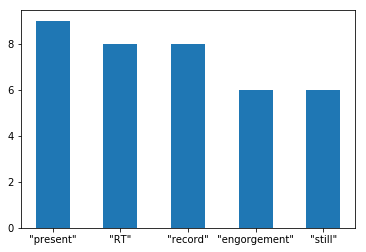

In [21]:
#早照會中前五大主要被使用的藥品
plt.bar(x,y,width=0.5)

### 第十步:
    重複第八步以及第九步的步驟，套用在晚照會的病人中

In [22]:
x2=[]
y2=[]
for k in kforlate:
    if k[1]>=5:
        x2.append(k[0])
        y2.append(k[1])

<BarContainer object of 5 artists>

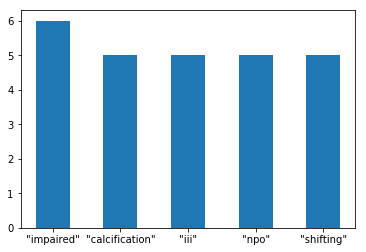

In [23]:
#晚照會中前五大主要被使用的藥品
plt.bar(x2,y2,width=0.5)

### 小結 : 
            在早照會病患中，前五大主要使用的藥物分別為 - "present"、 "RT" 、"record"、"engorgement"、"still"
            而在晚照會病患中，前五大主要使用的藥物則分別為- "impaired"、"calcification"、"iiii"、"npo"、"shifting"

### Q2:根據藥物作為特徵值，探勘是否關聯性較高的病人，會在同個早照會或是晚照會的組別裡?

### 第一步:
    利用病人區別資料，將藥物當特徵值

In [24]:
Papa=dict()
for drugid,row in enumerate(open('dfall (1).csv')):
    if drugid != 0:
        for patientid,k in enumerate(row.split(',')):
            if patientid > 1:
                Papa[row.split(',')[1].replace('"','')] = dict()
for drugid,row in enumerate(open('dfall (1).csv')):
    if drugid != 0:
        for patientid,k in enumerate(row.split(',')):
            if patientid > 1:
                k=int(k.replace('"',''))
                Papa[row.split(',')[1].replace('"','')][patient_index[patientid-2].replace('"','')] = k

In [25]:
df = pd.DataFrame(Papa)
df.head()

,MICU,ER,IAI,CRRT,PSA,ADLs,on,CXR,CK,CT,...,ureteritis,bout,china,giant,scd,svt,termination,osteomyelitis,pseudophakia,steal
X1,1,1,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
X10,0,0,1,0,0,0,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
X100,0,1,0,0,0,0,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
X101,0,1,0,0,1,0,1,0,1,1,...,0,0,0,0,0,0,0,0,0,0
X102,1,1,0,0,0,0,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0


### 第二步:
    採用PCA，import  sklearn

In [26]:
from sklearn.preprocessing import StandardScaler

In [27]:
features=[]
for k in Papa:
    if k != 'target':
        features.append(k)

In [28]:
Papa['target']=dict()
for i,k in enumerate(Papa['MICU']):
    k = k.replace('"','').replace('\n','')
    if k != '.rownames':
        Papa['target'][k] = k

In [29]:
print(Papa['MICU'])

{'X1': 1, 'X2': 0, 'X3': 0, 'X4': 0, 'X5': 0, 'X6': 0, 'X7': 0, 'X8': 0, 'X9': 0, 'X10': 0, 'X11': 0, 'X12': 0, 'X13': 0, 'X14': 0, 'X15': 0, 'X16': 0, 'X17': 0, 'X18': 0, 'X19': 1, 'X20': 0, 'X21': 0, 'X22': 1, 'X23': 1, 'X24': 0, 'X25': 0, 'X26': 0, 'X27': 0, 'X28': 0, 'X29': 1, 'X30': 0, 'X31': 0, 'X32': 0, 'X33': 0, 'X34': 0, 'X35': 0, 'X36': 0, 'X37': 0, 'X38': 0, 'X39': 0, 'X40': 0, 'X41': 1, 'X42': 0, 'X43': 0, 'X44': 0, 'X45': 0, 'X46': 0, 'X47': 0, 'X48': 0, 'X49': 1, 'X50': 0, 'X51': 0, 'X52': 0, 'X53': 0, 'X54': 1, 'X55': 0, 'X56': 0, 'X57': 0, 'X58': 0, 'X59': 0, 'X60': 0, 'X61': 0, 'X62': 0, 'X63': 0, 'X64': 1, 'X65': 1, 'X66': 0, 'X67': 1, 'X68': 0, 'X69': 0, 'X70': 0, 'X71': 0, 'X72': 1, 'X73': 0, 'X74': 0, 'X75': 0, 'X76': 0, 'X77': 1, 'X78': 0, 'X79': 0, 'X80': 0, 'X81': 0, 'X82': 0, 'X83': 0, 'X84': 0, 'X85': 0, 'X86': 0, 'X87': 0, 'X88': 0, 'X89': 0, 'X90': 1, 'X91': 0, 'X92': 0, 'X93': 1, 'X94': 1, 'X95': 0, 'X96': 0, 'X97': 0, 'X98': 0, 'X99': 0, 'X100': 0, 'X101':

In [30]:
df = pd.DataFrame(Papa)
df.head()

,MICU,ER,IAI,CRRT,PSA,ADLs,on,CXR,CK,CT,...,ureteritis,bout,china,giant,scd,svt,termination,osteomyelitis,pseudophakia,steal
X1,1,1,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
X10,0,0,1,0,0,0,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
X100,0,1,0,0,0,0,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
X101,0,1,0,0,1,0,1,0,1,1,...,0,0,0,0,0,0,0,0,0,0
X102,1,1,0,0,0,0,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0


In [31]:
x = df.loc[:, features].values

In [32]:
print(df.loc[:, features].values)

[[1 1 1 ... 0 0 0]
 [0 0 1 ... 0 0 0]
 [0 1 0 ... 0 0 0]
 ...
 [0 1 0 ... 0 0 0]
 [0 1 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


In [33]:
y = df.loc[:,['target']].values

In [34]:
x = StandardScaler().fit_transform(x)

C:\Users\James\Anaconda2\envs\python3\lib\site-packages\sklearn\utils\validation.py:595: DataConversionWarning: Data with input dtype int64 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
C:\Users\James\Anaconda2\envs\python3\lib\site-packages\sklearn\utils\validation.py:595: DataConversionWarning: Data with input dtype int64 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


In [35]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

In [36]:
print(principalDf)

     principal component 1  principal component 2
0                 5.962309               2.379206
1                10.929784               1.378415
2                -1.984453               0.520749
3                -0.944581               2.063719
4                -1.875127               1.488927
5                -5.137776              -2.902123
6                -4.119172               0.755808
7                -5.067409              -0.809267
8                -5.611440               0.257230
9                -4.552449              -1.139609
10               -5.406961              -2.287552
11                0.809776               1.026924
12               -3.988005              -0.436211
13               -5.241611              -0.341108
14              -16.737523              -8.664285
15              -16.737523              -8.664285
16              -16.737523              -8.664285
17              -16.737523              -8.664285
18               -4.030042              -0.072293


In [37]:
finalDf = pd.concat([principalDf], axis = 1)

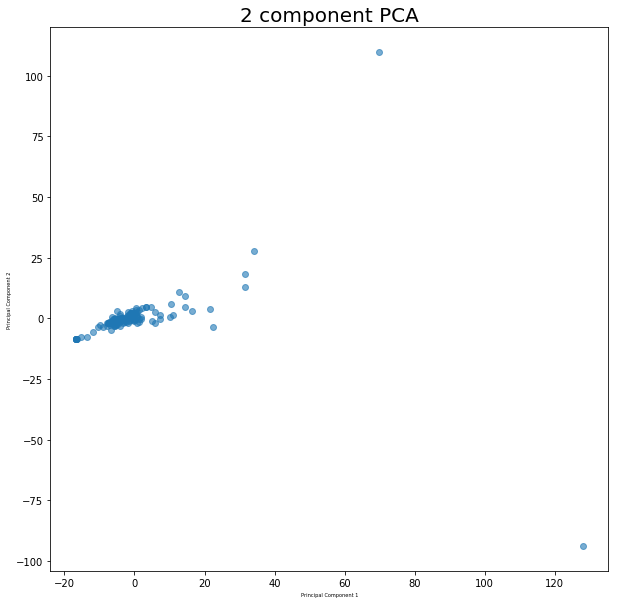

In [38]:
fig = plt.figure(figsize = (10,10))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 5)
ax.set_ylabel('Principal Component 2', fontsize = 5)
ax.set_title('2 component PCA', fontsize = 20)
plt.scatter(finalDf['principal component 1'],finalDf['principal component 2'], alpha=0.6)  

In [43]:
for i,j in enumerate(principalComponents):
    if principalComponents[i][0] > 120:
        print(i)
for i,j in enumerate(principalComponents):
    if principalComponents[i][1] > 100:
        print(i)

57
85


### 小結論:
    由圖發現將藥物降維後，有離群的病患，進一步發現分別為第57與第85位病患!

### 第三步:使用K-means 分群

In [123]:
from sklearn.cluster import KMeans

In [147]:
clf = KMeans(n_clusters=8)

In [148]:
clf.fit(finalDf)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=8, n_init=10, n_jobs=None, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [149]:
clf.labels_

array([7, 7, 4, 4, 4, 0, 0, 0, 0, 0, 0, 4, 0, 0, 5, 5, 5, 5, 0, 0, 4, 7,
       0, 0, 4, 0, 0, 0, 0, 4, 4, 0, 0, 4, 1, 1, 0, 0, 4, 4, 4, 7, 4, 4,
       4, 4, 1, 7, 4, 0, 5, 4, 0, 4, 0, 4, 0, 2, 6, 0, 7, 0, 4, 1, 0, 4,
       0, 6, 4, 0, 0, 0, 5, 7, 4, 4, 4, 0, 7, 4, 4, 4, 6, 0, 5, 3, 1, 0,
       5, 0, 7, 0, 4, 0, 4, 4, 0, 4, 5, 4, 0, 4, 5, 0, 5, 7, 0, 1, 4, 7,
       0, 4, 0, 0, 4, 0, 4, 0, 4, 4, 0, 0, 0, 0])

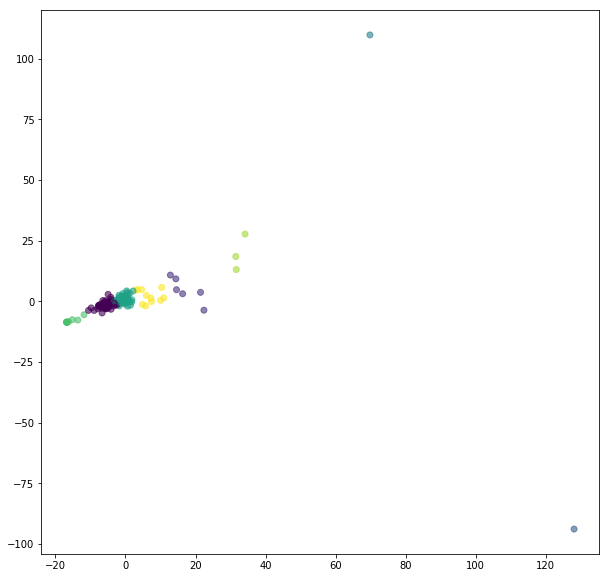

In [150]:
fig = plt.figure(figsize = (10,10))
plt.scatter(finalDf['principal component 1'],finalDf['principal component 2'], alpha=0.6,c=clf.labels_)  

In [151]:
team0=[]
team1=[]
team2=[]
for i,j in enumerate(clf.labels_):
    if j == 0:
        team0.append(patient_index[i])
    elif j == 4:
        team1.append(patient_index[i])
    elif j == 7:
        team2.append(patient_index[i])

In [152]:
print(team0)

['X6', 'X7', 'X8', 'X9', 'X10', 'X11', 'X13', 'X14', 'X19', 'X20', 'X23', 'X24', 'X26', 'X27', 'X28', 'X29', 'X32', 'X33', 'X37', 'X38', 'X50', 'X53', 'X55', 'X57', 'X60', 'X62', 'X65', 'X67', 'X70', 'X71', 'X72', 'X78', 'X84', 'X88', 'X90', 'X92', 'X94', 'X97', 'X101', 'X104', 'X107', 'X111', 'X113', 'X114', 'X116', 'X118', 'X121', 'X122', 'X123', 'X124']


In [153]:
print(team1)

['X3', 'X4', 'X5', 'X12', 'X21', 'X25', 'X30', 'X31', 'X34', 'X39', 'X40', 'X41', 'X43', 'X44', 'X45', 'X46', 'X49', 'X52', 'X54', 'X56', 'X63', 'X66', 'X69', 'X75', 'X76', 'X77', 'X80', 'X81', 'X82', 'X93', 'X95', 'X96', 'X98', 'X100', 'X102', 'X109', 'X112', 'X115', 'X117', 'X119', 'X120']


In [154]:
print(team2)

['X1', 'X2', 'X22', 'X42', 'X48', 'X61', 'X74', 'X79', 'X91', 'X106', 'X110']


In [155]:
h0=0
h1=0
for k in team0:
    if k in early_patient:
        h0+=1
    elif k in late_patient:
        h1+=1
print (h0)
print (h1)

33
14


In [156]:
h0=0
h1=0
for k in team1:
    if k in early_patient:
        h0+=1
    elif k in late_patient:
        h1+=1
print (h0)
print (h1)

24
15


### 試著畫出關聯圖

In [2]:
import networkx as nx

In [3]:
related=[7, 7, 4, 4, 4, 0, 0, 0, 0, 0, 0, 4, 0, 0, 5, 5, 5, 5, 0, 0, 4, 7,
       0, 0, 4, 0, 0, 0, 0, 4, 4, 0, 0, 4, 1, 1, 0, 0, 4, 4, 4, 7, 4, 4,
       4, 4, 1, 7, 4, 0, 5, 4, 0, 4, 0, 4, 0, 2, 6, 0, 7, 0, 4, 1, 0, 4,
       0, 6, 4, 0, 0, 0, 5, 7, 4, 4, 4, 0, 7, 4, 4, 4, 6, 0, 5, 3, 1, 0,
       5, 0, 7, 0, 4, 0, 4, 4, 0, 4, 5, 4, 0, 4, 5, 0, 5, 7, 0, 1, 4, 7,
       0, 4, 0, 0, 4, 0, 4, 0, 4, 4, 0, 0, 0, 0]
G=nx.DiGraph()#initial
for i,a in enumerate(related):
    for j,b in enumerate(related):
        if i != j:
            if a == b:
                G.add_edge(i,j)
            

In [22]:
plt.figure(figsize=(100,100)) 
nx.draw(G,pos = nx.random_layout(G),node_color = 'b',edge_color = 'r',with_labels = True,font_size =80,node_size =250)
plt.show()

### 小結: 
    根據分析發現，若單純以藥物作為特徵值，採用PCA降維，並利用kmeans分群後，在同一群(關聯性較高)，與是否都在早照會，或是晚照會無關! 考慮刪除部分藥物(例如幾乎每位病患都有的特徵值)，以及增加其他特徵值例如(年齡、性別、症狀等)繼續分析

## Q3:重新改善特徵值做關聯分析

### 第一步:
    將病患降維，進一步剔除離群的特徵值

In [44]:
df = pd.DataFrame(Papa)
x = df.loc[:, features].values

In [45]:
#從屬性的角度(轉置)
xx=[]
for i in range(len(x[0])):
    xx.append([0]*124)
for indexr,i in enumerate(x):
    for indexc,j in enumerate(i):
        xx[indexc][indexr]= j

In [46]:
x = StandardScaler().fit_transform(xx)

In [47]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])

In [51]:
finalDf = pd.concat([principalDf], axis = 1)

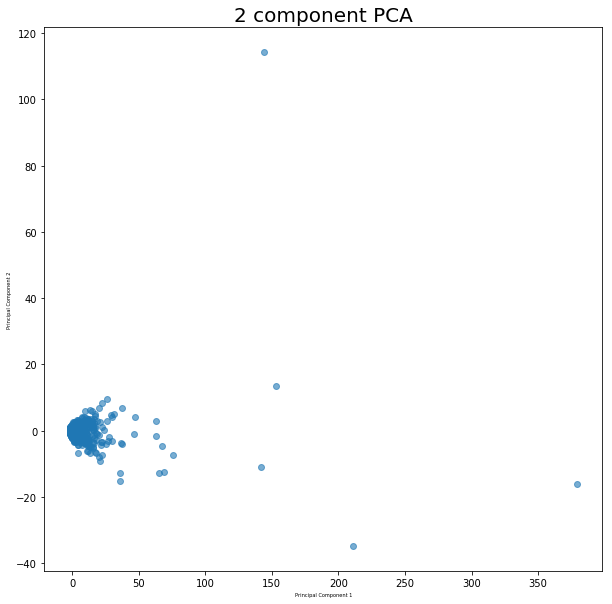

In [52]:
fig = plt.figure(figsize = (10,10))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 5)
ax.set_ylabel('Principal Component 2', fontsize = 5)
ax.set_title('2 component PCA', fontsize = 20)
plt.scatter(finalDf['principal component 1'],finalDf['principal component 2'], alpha=0.6)  

In [59]:
outrange=[]
for i,j in enumerate(principalComponents):
    if principalComponents[i][0] > 100:
        outrange.append(i)
        print(i)
for i,j in enumerate(principalComponents):
    if principalComponents[i][1] > 100:
        if i in outrange:
            pass
        else:
            outrange.append(i)
            print(i)

814
1009
1308
1361
3709


In [60]:
for i,j in enumerate(principalComponents):
    if principalComponents[i][0] > 350:
        print(i)

814


In [61]:
print(drug[814])

anasarca


In [62]:
for i in outrange:
    print(drug[i])

anasarca
flatulence
systemic
volume
trapezius


### 小結論: 
    根據圖發現有六個離群的藥物，其中差最多的為"anasarce"，其他藥物則分別為 : "flatulence"、"systemic"、"volume"、"trapezius

### Q4:
    這些離群藥物分別使用在哪些病患中?

In [66]:
for i in patient:
    if '"anasarca"' in patient[i]:
        print(i)

X4
X5


In [67]:
for i in patient:
    if '"flatulence"' in patient[i]:
        print(i)

X22
X26
X30
X34
X42
X46
X58
X62
X66
X70
X78
X82
X86
X90
X94
X102
X106
X110
X118
X122


In [68]:
for i in patient:
    if '"systemic"' in patient[i]:
        print(i)

X3
X19
X23
X27
X43
X55
X63
X67
X79
X83
X91
X95
X99
X103
X115
X119
X123


In [69]:
for i in patient:
    if '"volume"' in patient[i]:
        print(i)

X25
X29
X89
X97
X121
